<a href="https://colab.research.google.com/github/Liorinio/Animal-Classification/blob/main/Animal_classification_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install torchvision timm
!pip install opencv-python
!pip install cv2
!pip install torch-xla

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.0/52.0 kB 2.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.4/2.4 MB 31.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.0/63.0 MB 20.3 MB/s eta 0:00:00
ERROR: Could not find a version that satisfies the requirement cv2 (from versions: none)
ERROR: No matching distribution found for cv2


In [2]:
from google.colab import drive
from PIL import Image, ImageOps
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
from pathlib import Path
from tqdm import tqdm
import os
import concurrent.futures
import plotly.express as px
from sklearn.model_selection import train_test_split
import cv2
import random

import torch
import torch.nn as nn
from torchvision import transforms, datasets
from torch.utils.data import DataLoader, random_split, Dataset
from sklearn.metrics import classification_report
import timm
import torch.optim as optim
from sklearn.preprocessing import LabelEncoder
import torch_xla
import torch_xla.core.xla_model as xm
from torchvision import models
import joblib
from collections import Counter
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import json

In [3]:
def process_image(img_path, label):
    try:
        with Image.open(img_path) as img:
            # Convert to RGB to avoid issues with images in different modes (e.g. RGBA, L)
            img = img.convert("RGB")

            # Resize while keeping aspect ratio and add padding to make it exactly 256x256
            img.thumbnail((256, 256), Image.Resampling.LANCZOS)  # Use modern resampling method
            delta_w = 256 - img.width
            delta_h = 256 - img.height
            padding = (
                delta_w // 2,
                delta_h // 2,
                delta_w - (delta_w // 2),
                delta_h - (delta_h // 2)
            )
            padded_img = ImageOps.expand(img, padding, fill=(0, 0, 0))  # Black padding

            # Overwrite the image
            padded_img.save(img_path)

        return {'image_path': img_path, 'label': label}
    except Exception as e:
        print(f"Error loading or resizing image {img_path}: {e}")
        return None

def load_images_to_dataframe(main_folder_path):
    # Ensure this function only runs in Google Colab
    if 'google.colab' in str(get_ipython()):
        drive.mount('/content/drive', force_remount=True)

    data = []

    # Use a ThreadPoolExecutor to parallelize the processing of images
    with concurrent.futures.ThreadPoolExecutor() as executor:
        futures = []
        for label in os.listdir(main_folder_path):
            label_path = os.path.join(main_folder_path, label)
            if os.path.isdir(label_path):
                for filename in os.listdir(label_path):
                    if filename.lower().endswith(('.jpg', '.jpeg', '.png', '.bmp')):
                        img_path = os.path.join(label_path, filename)
                        futures.append(executor.submit(process_image, img_path, label))

        for future in concurrent.futures.as_completed(futures):
            result = future.result()
            if result:
                data.append(result)

    return pd.DataFrame(data)


In [4]:
main_folder_path = '/content/drive/MyDrive/Datasets/Animals_dataset_2/animals'
df = load_images_to_dataframe(main_folder_path)
print(df.head())

Mounted at /content/drive
                                          image_path       label
0  /content/drive/MyDrive/Datasets/Animals_datase...  chimpanzee
1  /content/drive/MyDrive/Datasets/Animals_datase...         cow
2  /content/drive/MyDrive/Datasets/Animals_datase...    antelope
3  /content/drive/MyDrive/Datasets/Animals_datase...          ox
4  /content/drive/MyDrive/Datasets/Animals_datase...   butterfly


In [5]:
df.describe()

,image_path,label
count,5700,5700
unique,5700,95
top,/content/drive/MyDrive/Datasets/Animals_datase...,chimpanzee
freq,1,60


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5700 entries, 0 to 5699
Data columns (total 2 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   image_path  5700 non-null   object
 1   label       5700 non-null   object
dtypes: object(2)
memory usage: 89.2+ KB


In [7]:
df.isnull().sum()

,0
image_path,0
label,0


In [8]:
df = df.sort_values(by='label', ascending=True).reset_index(drop=True)
df.head()

,image_path,label
0,/content/drive/MyDrive/Datasets/Animals_datase...,antelope
1,/content/drive/MyDrive/Datasets/Animals_datase...,antelope
2,/content/drive/MyDrive/Datasets/Animals_datase...,antelope
3,/content/drive/MyDrive/Datasets/Animals_datase...,antelope
4,/content/drive/MyDrive/Datasets/Animals_datase...,antelope


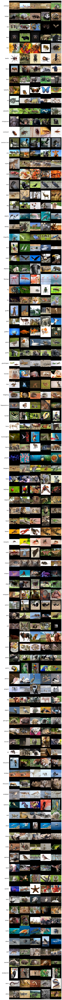

In [9]:
# Get all unique categories
all_categories = df["label"].unique()

# Filter dataset to include all images
filtered_df = df[df["label"].isin(all_categories)]

# Number of images per category
num_samples_per_category = 5  # Adjust if needed
image_grid = []
labels_list = []

for category in all_categories:
    category_images = df[df["label"] == category]["image_path"].values

    # Ensure unique random selection of images
    if len(category_images) >= num_samples_per_category:
        selected_images = random.sample(list(category_images), num_samples_per_category)
    else:
        selected_images = category_images  # If fewer images exist, take all available

    row_images = []

    for image_path in selected_images:
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        # Resize images to a fixed width and height while maintaining aspect ratio.
        image = cv2.resize(image, (256, 256))  # Resize to a fixed size
        row_images.append(image)

    # Stack images horizontally to create a row
    image_grid.append(np.hstack(row_images))
    labels_list.append(category)  # Save label for this row

# Stack all rows vertically to form the final grid
final_image = np.vstack(image_grid)

# Display the image grid with labels
fig, ax = plt.subplots(figsize=(30, len(all_categories) * 2))  # Adjust height dynamically
ax.imshow(final_image)
ax.axis("off")

# Add labels on the left side
for i, label in enumerate(labels_list):
   ax.text(
        -10,  # X position (negative to shift left)
        (i + 0.5) * final_image.shape[0] / len(labels_list),  # Center text in the row
        label,
        fontsize=12,
        color="black",
        weight="normal",
        ha="right",  # Align to the right
        va="center",  # Center vertically
    )

plt.show()

In [10]:
def get_image_shape(df, index):
    # Get the image path from the DataFrame at the given index
    img_path = df['image_path'].iloc[index]

    # Open the image using PIL
    with Image.open(img_path) as img:
        # Convert the image to a numpy array to get the shape
        img_array = np.array(img)

    # Return the shape of the image
    return img_array.shape

for i in range(1, df.shape[0], 500):
  print(get_image_shape(df, i))

(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


In [11]:
labels = []
counts = []
label_counts = df.iloc[:, 1].value_counts()
for label, count in label_counts.items():
  labels.append(label)
  counts.append(count)
df_counts = pd.DataFrame({'label': labels, 'count': counts})
df_counts = df_counts.sort_values(by='label', ascending=True).reset_index(drop=True)
df_counts.head()

,label,count
0,antelope,60
1,badger,60
2,bat,60
3,bear,60
4,bee,60


In [12]:
fig = px.bar(df_counts,
             x='label',
             y='count',
             title='Distribution of Animal Classes',
             color='label', # <-- Set color to 'label' to color bars by animal class.
             color_continuous_scale='Viridis',
             template='plotly_dark')
fig.update_layout(title_font_size=24, title_x=0.5, xaxis_title_font_size=18, yaxis_title_font_size=18, font=dict(family="Arial, sans-serif", size=14))
fig.show()

In [13]:
label_list = []
for i in range(0, df.shape[0], 60):
    label_list.append(df.loc[i, "label"])
label_dict = {item: index for index, item in enumerate(label_list)}
print(label_dict)

{'antelope': 0, 'badger': 1, 'bat': 2, 'bear': 3, 'bee': 4, 'beetle': 5, 'bison': 6, 'boar': 7, 'butterfly': 8, 'cat': 9, 'caterpillar': 10, 'chimpanzee': 11, 'cockroach': 12, 'common loon': 13, 'cow': 14, 'coyote': 15, 'crab': 16, 'crow': 17, 'deer': 18, 'dog': 19, 'dolphin': 20, 'donkey': 21, 'dragonfly': 22, 'duck': 23, 'eagle': 24, 'elephant': 25, 'flamingo': 26, 'fly': 27, 'fox': 28, 'giraffe': 29, 'goat': 30, 'goldfish': 31, 'goose': 32, 'gorilla': 33, 'grasshopper': 34, 'hamster': 35, 'hare': 36, 'hedgehog': 37, 'hippopotamus': 38, 'hornbill': 39, 'horse': 40, 'hummingbird': 41, 'hyena': 42, 'jellyfish': 43, 'kangaroo': 44, 'koala': 45, 'ladybugs': 46, 'leopard': 47, 'lion': 48, 'lizard': 49, 'lobster': 50, 'mosquito': 51, 'moth': 52, 'mouse': 53, 'octopus': 54, 'okapi': 55, 'orangutan': 56, 'ostrich': 57, 'otter': 58, 'owl': 59, 'ox': 60, 'oyster': 61, 'panda': 62, 'parrot': 63, 'pelican': 64, 'penguin': 65, 'pig': 66, 'pigeon': 67, 'porcupine': 68, 'possum': 69, 'raccoon': 70,

In [14]:
df.replace({"label": label_dict}, inplace=True)
for i in range(0, df.shape[0], 60):
  print(df.loc[i])

image_path    /content/drive/MyDrive/Datasets/Animals_datase...
label                                                         0
Name: 0, dtype: object
image_path    /content/drive/MyDrive/Datasets/Animals_datase...
label                                                         1
Name: 60, dtype: object
image_path    /content/drive/MyDrive/Datasets/Animals_datase...
label                                                         2
Name: 120, dtype: object
image_path    /content/drive/MyDrive/Datasets/Animals_datase...
label                                                         3
Name: 180, dtype: object
image_path    /content/drive/MyDrive/Datasets/Animals_datase...
label                                                         4
Name: 240, dtype: object
image_path    /content/drive/MyDrive/Datasets/Animals_datase...
label                                                         5
Name: 300, dtype: object
image_path    /content/drive/MyDrive/Datasets/Animals_datase...
label                

<ipython-input-14-001d39f64990>:1: FutureWarning:

Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`



In [15]:
# Create the directory if it doesn't exist
os.makedirs("/content/drive/MyDrive/LabelDict", exist_ok=True)

# Save to file
with open('/content/drive/MyDrive/LabelDict.json', 'w') as f:
    json.dump(label_dict, f)

In [16]:
with open('/content/drive/MyDrive/LabelDict.json', 'r') as f:
    loaded_dict = json.load(f)

print(loaded_dict)

{'antelope': 0, 'badger': 1, 'bat': 2, 'bear': 3, 'bee': 4, 'beetle': 5, 'bison': 6, 'boar': 7, 'butterfly': 8, 'cat': 9, 'caterpillar': 10, 'chimpanzee': 11, 'cockroach': 12, 'common loon': 13, 'cow': 14, 'coyote': 15, 'crab': 16, 'crow': 17, 'deer': 18, 'dog': 19, 'dolphin': 20, 'donkey': 21, 'dragonfly': 22, 'duck': 23, 'eagle': 24, 'elephant': 25, 'flamingo': 26, 'fly': 27, 'fox': 28, 'giraffe': 29, 'goat': 30, 'goldfish': 31, 'goose': 32, 'gorilla': 33, 'grasshopper': 34, 'hamster': 35, 'hare': 36, 'hedgehog': 37, 'hippopotamus': 38, 'hornbill': 39, 'horse': 40, 'hummingbird': 41, 'hyena': 42, 'jellyfish': 43, 'kangaroo': 44, 'koala': 45, 'ladybugs': 46, 'leopard': 47, 'lion': 48, 'lizard': 49, 'lobster': 50, 'mosquito': 51, 'moth': 52, 'mouse': 53, 'octopus': 54, 'okapi': 55, 'orangutan': 56, 'ostrich': 57, 'otter': 58, 'owl': 59, 'ox': 60, 'oyster': 61, 'panda': 62, 'parrot': 63, 'pelican': 64, 'penguin': 65, 'pig': 66, 'pigeon': 67, 'porcupine': 68, 'possum': 69, 'raccoon': 70,

In [17]:
df['label'] = df['label'].astype(str)
train, test = train_test_split(df, test_size=0.2, random_state=42, stratify=df['label'])

X_train, y_train = train["image_path"].values, train["label"].values
X_test, y_test = test["image_path"].values, test["label"].values

In [18]:
def print_image_info(dataset, num_samples):
    num_samples = min(num_samples, len(dataset)) # Ensure num_samples is within bounds
    # Sample and print information for each image in the dataset
    for i in range(num_samples):
        image_path = dataset[i]  # Access image path from the NumPy array
        image = plt.imread(image_path) # Read image using matplotlib.pyplot
        # Get the shape of the image
        shape = image.shape
        # Get the image mode
        image_mode = 'RGB' if shape[-1] == 3 else 'Grayscale'
        # Print the information
        print(f"Image Shape: {shape} \nImage Mode: {image_mode}\n")

In [19]:
print_image_info(X_train, 5)

Image Shape: (256, 256, 3) 
Image Mode: RGB

Image Shape: (256, 256, 3) 
Image Mode: RGB

Image Shape: (256, 256, 3) 
Image Mode: RGB

Image Shape: (256, 256, 3) 
Image Mode: RGB

Image Shape: (256, 256, 3) 
Image Mode: RGB



# Model 1

In [20]:
# ✅ Detect TPU or GPU/CPU
device = (torch_xla.core.xla_model.xla_device() if 'COLAB_TPU_ADDR' in os.environ else
          torch.device('cuda' if torch.cuda.is_available() else 'cpu'))

# ✅ Define Custom CNN + FFNN Classifier
class CustomCNNFFNN(nn.Module):
    def __init__(self, num_classes):
        super(CustomCNNFFNN, self).__init__()
        self.conv1 = nn.Conv2d(3, 32, kernel_size=3, padding=1)
        self.bn1 = nn.BatchNorm2d(32)
        self.pool1 = nn.MaxPool2d(2, 2)

        self.conv2 = nn.Conv2d(32, 64, kernel_size=3, padding=1)
        self.bn2 = nn.BatchNorm2d(64)
        self.pool2 = nn.MaxPool2d(2, 2)

        self.dropout = nn.Dropout(0.5)

        # Calculate flattened_size dynamically based on input size (224x224)
        self.flattened_size = 64 * 56 * 56  # After conv layers on 224x224 input

        self.fc1 = nn.Linear(self.flattened_size, 1024)
        self.fc2 = nn.Linear(1024, 512)
        self.fc3 = nn.Linear(512, 256)
        self.fc4 = nn.Linear(256, 128)
        self.fc5 = nn.Linear(128, num_classes)
        self.relu = nn.ReLU()

    def forward(self, x):
        x = self.pool1(self.relu(self.bn1(self.conv1(x)))) # Pass through conv1, bn1, relu, and pool1
        x = self.pool2(self.relu(self.bn2(self.conv2(x)))) # Pass through conv2, bn2, relu, and pool2
        x = x.view(x.size(0), -1) # Flatten the output for the fully connected layers
        x = self.dropout(x)
        x = self.relu(self.fc1(x))
        x = self.relu(self.fc2(x))
        x = self.relu(self.fc3(x))
        x = self.relu(self.fc4(x))
        x = self.fc5(x)
        return x

# ✅ Define Custom Dataset
class CustomDataset(Dataset):
    def __init__(self, image_paths, labels, transform=None):
        self.image_paths = image_paths
        self.labels = labels
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image = Image.open(self.image_paths[idx]).convert("RGB")
        label = self.labels[idx]
        if self.transform:
            image = self.transform(image)
        return image, label

# ✅ Data Transforms
train_transform = transforms.Compose([
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(15),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2),
    transforms.Resize((224, 224)),
    transforms.ToTensor()
])

evaluation_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor()
])

In [21]:
# ✅ Encode Labels
label_encoder = LabelEncoder()
all_labels = y_train.tolist() + y_test.tolist()
label_encoder.fit(all_labels)

y_train_encoded = label_encoder.transform(y_train)
y_test_encoded = label_encoder.transform(y_test)

y_train_tensor = torch.tensor(y_train_encoded, dtype=torch.long)
y_test_tensor = torch.tensor(y_test_encoded, dtype=torch.long)

# ✅ DataLoaders
train_dataset = CustomDataset(X_train, y_train_tensor, transform=train_transform)
test_dataset = CustomDataset(X_test, y_test_tensor, transform=evaluation_transform)
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

# ✅ Load Pretrained ResNet18
model = models.resnet18(pretrained=True)

# ✅ Freeze Feature Extractor
for param in model.parameters():
    param.requires_grad = False

# ✅ Replace Final FC Layer
num_classes = len(label_encoder.classes_)
model.fc = nn.Linear(model.fc.in_features, num_classes)

# ✅ Unfreeze Classifier
for param in model.fc.parameters():
    param.requires_grad = True

model.to(device)

# ✅ Loss & Optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.fc.parameters(), lr=0.001, weight_decay=1e-4)
# ✅ Trackers
train_loss_history, train_acc_history = [], []
test_loss_history, test_acc_history = [], []

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning:

The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning:

Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.

Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 166MB/s]


In [22]:
# Create the directory if it doesn't exist
os.makedirs("/content/drive/MyDrive/LabelEncoder", exist_ok=True)

# Save the label_encoder object to a file
joblib.dump(label_encoder, "/content/drive/MyDrive/LabelEncoder/labelencoder.pkl")

# Now, you can load it using:
label_encoder = joblib.load("/content/drive/MyDrive/LabelEncoder/labelencoder.pkl")
class_names = list(label_encoder.classes_)
print(class_names)

[np.str_('0'), np.str_('1'), np.str_('10'), np.str_('11'), np.str_('12'), np.str_('13'), np.str_('14'), np.str_('15'), np.str_('16'), np.str_('17'), np.str_('18'), np.str_('19'), np.str_('2'), np.str_('20'), np.str_('21'), np.str_('22'), np.str_('23'), np.str_('24'), np.str_('25'), np.str_('26'), np.str_('27'), np.str_('28'), np.str_('29'), np.str_('3'), np.str_('30'), np.str_('31'), np.str_('32'), np.str_('33'), np.str_('34'), np.str_('35'), np.str_('36'), np.str_('37'), np.str_('38'), np.str_('39'), np.str_('4'), np.str_('40'), np.str_('41'), np.str_('42'), np.str_('43'), np.str_('44'), np.str_('45'), np.str_('46'), np.str_('47'), np.str_('48'), np.str_('49'), np.str_('5'), np.str_('50'), np.str_('51'), np.str_('52'), np.str_('53'), np.str_('54'), np.str_('55'), np.str_('56'), np.str_('57'), np.str_('58'), np.str_('59'), np.str_('6'), np.str_('60'), np.str_('61'), np.str_('62'), np.str_('63'), np.str_('64'), np.str_('65'), np.str_('66'), np.str_('67'), np.str_('68'), np.str_('69'), n

In [23]:
# ✅ Initialize best values
best_train_loss = float('inf')
best_test_loss = float('inf')
best_train_acc = 0.0
best_test_acc = 0.0

# ✅ Training + Evaluation Loop with Best Model Saving
num_epochs = 10

for epoch in range(num_epochs):
    # ---------- Training ----------
    model.train()
    running_loss, correct, total = 0.0, 0, 0

    for images, labels in tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs} - Training"):
        images, labels = images.to(device), labels.to(device)
        optimizer.zero_grad()

        outputs = model(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()
        _, predicted = torch.max(outputs, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

    train_loss = running_loss / len(train_loader)
    train_acc = 100 * correct / total
    train_loss_history.append(train_loss)
    train_acc_history.append(train_acc)

    print(f"Epoch [{epoch+1}/{num_epochs}], Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.2f}%")

    # ✅ Save if best train loss
    if train_loss < best_train_loss:
        best_train_loss = train_loss
        torch.save(model.state_dict(), '/content/drive/MyDrive/savedSecondModelProjectAnimals.pth')
        print("✅ Saved model (best train loss)")

    # ✅ Save if best train accuracy
    if train_acc > best_train_acc:
        best_train_acc = train_acc
        torch.save(model.state_dict(), '/content/drive/MyDrive/savedSecondModelProjectAnimals.pth')
        print("✅ Saved model (best train acc)")

    # ---------- Evaluation ----------
    model.eval()
    test_loss, correct, total = 0.0, 0, 0

    with torch.no_grad():
        for images, labels in tqdm(test_loader, desc=f"Epoch {epoch+1}/{num_epochs} - Testing"):
            images, labels = images.to(device), labels.to(device)

            outputs = model(images)
            loss = criterion(outputs, labels)

            test_loss += loss.item()
            _, predicted = torch.max(outputs, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

    test_loss /= len(test_loader)
    test_acc = 100 * correct / total
    test_loss_history.append(test_loss)
    test_acc_history.append(test_acc)

    print(f"Epoch [{epoch+1}/{num_epochs}], Test Loss: {test_loss:.4f}, Test Acc: {test_acc:.2f}%")

    # ✅ Save if best test loss
    if test_loss < best_test_loss:
        best_test_loss = test_loss
        torch.save(model.state_dict(), '/content/drive/MyDrive/savedSecondModelProjectAnimals.pth')
        print("✅ Saved model (best test loss)")

    # ✅ Save if best test accuracy
    if test_acc > best_test_acc:
        best_test_acc = test_acc
        torch.save(model.state_dict(), '/content/drive/MyDrive/savedSecondModelProjectAnimals.pth')
        print("✅ Saved model (best test acc)")

Epoch 1/10 - Training: 100%|██████████| 143/143 [01:00<00:00,  2.36it/s]


Epoch [1/10], Train Loss: 3.1792, Train Acc: 35.88%
✅ Saved model (best train loss)
✅ Saved model (best train acc)


Epoch 1/10 - Testing: 100%|██████████| 36/36 [00:11<00:00,  3.12it/s]


Epoch [1/10], Test Loss: 1.7185, Test Acc: 70.53%
✅ Saved model (best test loss)
✅ Saved model (best test acc)


Epoch 2/10 - Training: 100%|██████████| 143/143 [00:59<00:00,  2.39it/s]


Epoch [2/10], Train Loss: 1.4780, Train Acc: 73.38%
✅ Saved model (best train loss)
✅ Saved model (best train acc)


Epoch 2/10 - Testing: 100%|██████████| 36/36 [00:11<00:00,  3.09it/s]


Epoch [2/10], Test Loss: 1.0555, Test Acc: 77.72%
✅ Saved model (best test loss)
✅ Saved model (best test acc)


Epoch 3/10 - Training: 100%|██████████| 143/143 [01:00<00:00,  2.34it/s]


Epoch [3/10], Train Loss: 0.9959, Train Acc: 80.75%
✅ Saved model (best train loss)
✅ Saved model (best train acc)


Epoch 3/10 - Testing: 100%|██████████| 36/36 [00:11<00:00,  3.14it/s]


Epoch [3/10], Test Loss: 0.8156, Test Acc: 82.28%
✅ Saved model (best test loss)
✅ Saved model (best test acc)


Epoch 4/10 - Training: 100%|██████████| 143/143 [00:59<00:00,  2.39it/s]


Epoch [4/10], Train Loss: 0.7666, Train Acc: 84.76%
✅ Saved model (best train loss)
✅ Saved model (best train acc)


Epoch 4/10 - Testing: 100%|██████████| 36/36 [00:11<00:00,  3.27it/s]


Epoch [4/10], Test Loss: 0.7068, Test Acc: 82.37%
✅ Saved model (best test loss)
✅ Saved model (best test acc)


Epoch 5/10 - Training: 100%|██████████| 143/143 [00:59<00:00,  2.41it/s]


Epoch [5/10], Train Loss: 0.6504, Train Acc: 86.80%
✅ Saved model (best train loss)
✅ Saved model (best train acc)


Epoch 5/10 - Testing: 100%|██████████| 36/36 [00:11<00:00,  3.17it/s]


Epoch [5/10], Test Loss: 0.6686, Test Acc: 83.25%
✅ Saved model (best test loss)
✅ Saved model (best test acc)


Epoch 6/10 - Training: 100%|██████████| 143/143 [00:58<00:00,  2.43it/s]


Epoch [6/10], Train Loss: 0.5844, Train Acc: 86.84%
✅ Saved model (best train loss)
✅ Saved model (best train acc)


Epoch 6/10 - Testing: 100%|██████████| 36/36 [00:11<00:00,  3.03it/s]


Epoch [6/10], Test Loss: 0.6114, Test Acc: 83.51%
✅ Saved model (best test loss)
✅ Saved model (best test acc)


Epoch 7/10 - Training: 100%|██████████| 143/143 [01:00<00:00,  2.35it/s]


Epoch [7/10], Train Loss: 0.5077, Train Acc: 88.62%
✅ Saved model (best train loss)
✅ Saved model (best train acc)


Epoch 7/10 - Testing: 100%|██████████| 36/36 [00:11<00:00,  3.19it/s]


Epoch [7/10], Test Loss: 0.5833, Test Acc: 83.33%
✅ Saved model (best test loss)


Epoch 8/10 - Training: 100%|██████████| 143/143 [01:01<00:00,  2.33it/s]


Epoch [8/10], Train Loss: 0.4438, Train Acc: 90.83%
✅ Saved model (best train loss)
✅ Saved model (best train acc)


Epoch 8/10 - Testing: 100%|██████████| 36/36 [00:11<00:00,  3.18it/s]


Epoch [8/10], Test Loss: 0.5670, Test Acc: 85.44%
✅ Saved model (best test loss)
✅ Saved model (best test acc)


Epoch 9/10 - Training: 100%|██████████| 143/143 [01:00<00:00,  2.38it/s]


Epoch [9/10], Train Loss: 0.4094, Train Acc: 91.18%
✅ Saved model (best train loss)
✅ Saved model (best train acc)


Epoch 9/10 - Testing: 100%|██████████| 36/36 [00:10<00:00,  3.46it/s]


Epoch [9/10], Test Loss: 0.5533, Test Acc: 84.65%
✅ Saved model (best test loss)


Epoch 10/10 - Training: 100%|██████████| 143/143 [01:00<00:00,  2.37it/s]


Epoch [10/10], Train Loss: 0.3868, Train Acc: 91.05%
✅ Saved model (best train loss)


Epoch 10/10 - Testing: 100%|██████████| 36/36 [00:10<00:00,  3.31it/s]


Epoch [10/10], Test Loss: 0.5422, Test Acc: 84.65%
✅ Saved model (best test loss)


In [ ]:
# ✅ Print Metrics
print("\nTrain Loss History:", train_loss_history)
print("Train Accuracy History:", train_acc_history)
print("Test Loss History:", test_loss_history)
print("Test Accuracy History:", test_acc_history)


Train Loss History: [3.2399733925199175, 1.4746363438092744, 0.9796433115338946, 0.7798535450771972, 0.6470571650074912, 0.549004725955583, 0.49088939805547677, 0.4332175538256452, 0.4028981816205945, 0.3783696039573296]
Train Accuracy History: [34.21052631578947, 72.98245614035088, 81.29385964912281, 83.99122807017544, 86.62280701754386, 88.48684210526316, 89.71491228070175, 90.78947368421052, 91.40350877192982, 91.66666666666667]
Test Loss History: [1.7803465591536627, 1.105382149418195, 0.8831217818790011, 0.7641313821077347, 0.7131034284830093, 0.6651598206824727, 0.6253094416525629, 0.5906291024552451, 0.5952694705790944, 0.5862628118031554]
Test Accuracy History: [69.47368421052632, 76.66666666666667, 80.6140350877193, 81.2280701754386, 81.2280701754386, 82.54385964912281, 82.89473684210526, 84.47368421052632, 84.21052631578948, 82.10526315789474]


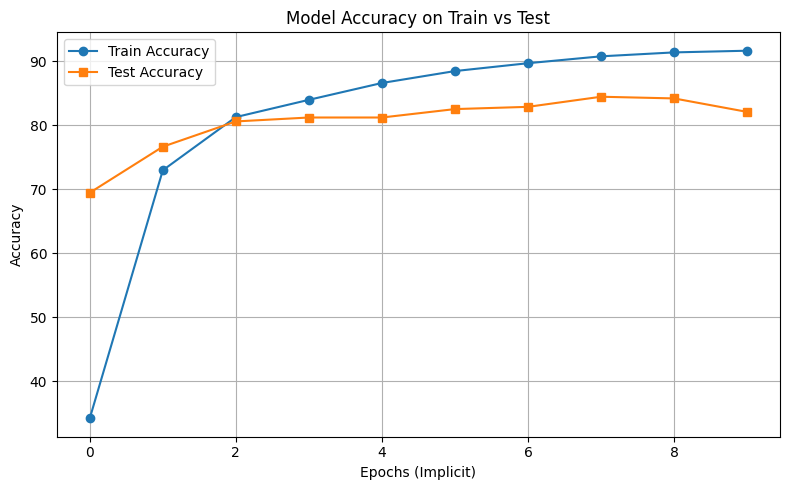

In [ ]:
plt.figure(figsize=(8, 5))
plt.plot(train_acc_history, label='Train Accuracy', marker='o')
plt.plot(test_acc_history, label='Test Accuracy', marker='s')
plt.title('Model Accuracy on Train vs Test')
plt.xlabel('Epochs (Implicit)')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

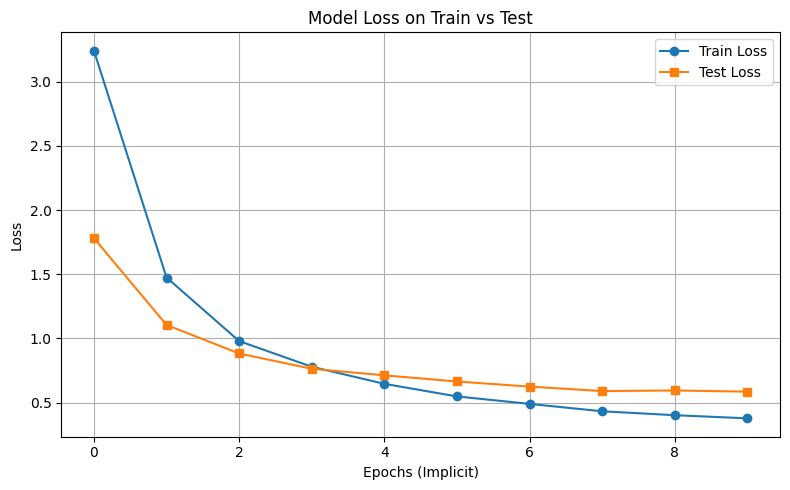

In [ ]:
plt.figure(figsize=(8, 5))
plt.plot(train_loss_history, label='Train Loss', marker='o')
plt.plot(test_loss_history, label='Test Loss', marker='s')
plt.title('Model Loss on Train vs Test')
plt.xlabel('Epochs (Implicit)')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
# Reverse it to decode numbers back to class names
decoding_dict = {v: k for k, v in label_dict.items()}

# ✅ Set model to eval mode and collect all predictions
model.eval()
all_preds = []
all_labels = []

with torch.no_grad():
    for images, labels in tqdm(test_loader, desc="Collecting Predictions"):
        images = images.to(device)
        outputs = model(images)
        _, preds = torch.max(outputs, 1)

        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

# ✅ Convert numeric labels back to animal names
all_labels_named = [decoding_dict[label] for label in all_labels]
all_preds_named = [decoding_dict[pred] for pred in all_preds]

# ✅ Identify misclassifications
misclassifications = [
    (true, pred) for true, pred in zip(all_labels_named, all_preds_named) if true != pred
]

# ✅ Count the number of times each misclassification occurred
misclass_count = Counter(misclassifications)

# ✅ Create a DataFrame for better readability
misclass_df = pd.DataFrame([
    {"Actual Label": actual, "Predicted Label": predicted, "Count": count}
    for (actual, predicted), count in misclass_count.items()
])

# ✅ Sort the DataFrame by count (descending)
misclass_df = misclass_df.sort_values(by="Count", ascending=False).reset_index(drop=True)

# ✅ Display the table
print("\n" + misclass_df.to_string(index=False))

In [ ]:
# Reverse it to decode numbers back to class names
decoding_dict = {v: k for k, v in label_dict.items()}

# Set model to eval mode and collect all predictions
model.eval()
all_preds = []
all_labels = []

with torch.no_grad():
    for images, labels in tqdm(test_loader, desc="Collecting Predictions"):
        images = images.to(device)
        outputs = model(images)
        _, preds = torch.max(outputs, 1)
        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

# Convert numeric labels back to class names
all_labels_named = [decoding_dict[label] for label in all_labels]
all_preds_named = [decoding_dict[pred] for pred in all_preds]

# Create a single confusion matrix over the entire test set
cm = confusion_matrix(all_labels_named, all_preds_named, labels=list(label_dict.keys()))

# Plot it once
plt.figure(figsize=(25, 25))
ax = plt.gca()
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=list(label_dict.keys()))
disp.plot(cmap="Blues", xticks_rotation=90, ax=ax)
ax.tick_params(axis='x', labelsize=12)
ax.tick_params(axis='y', labelsize=12)
plt.title("Confusion Matrix – All Test Data", fontsize=28)
plt.tight_layout()
plt.show()

# Model 2

In [ ]:
# ✅ # Detect TPU or GPU/CPU
device = xm.xla_device() if 'COLAB_TPU_ADDR' in os.environ else torch.device("cuda" if torch.cuda.is_available() else "cpu")

# ✅ Define Custom CNN + FFNN Classifier
class CustomCNNFFNN(nn.Module):
    def __init__(self, num_classes):
        super(CustomCNNFFNN, self).__init__()
        self.conv1 = nn.Conv2d(3, 32, kernel_size=3, padding=1)
        self.bn1 = nn.BatchNorm2d(32)
        self.pool1 = nn.MaxPool2d(2, 2)

        self.conv2 = nn.Conv2d(32, 64, kernel_size=3, padding=1)
        self.bn2 = nn.BatchNorm2d(64)
        self.pool2 = nn.MaxPool2d(2, 2)

        self.dropout = nn.Dropout(0.5)

        # Calculate flattened_size dynamically based on input size (224x224)
        self.flattened_size = 64 * 56 * 56  # After conv layers on 224x224 input

        self.fc1 = nn.Linear(self.flattened_size, 1024)
        self.fc2 = nn.Linear(1024, 512)
        self.fc3 = nn.Linear(512, 256)
        self.fc4 = nn.Linear(256, 128)
        self.fc5 = nn.Linear(128, num_classes)
        self.relu = nn.ReLU()

    def forward(self, x):
        x = self.pool1(self.relu(self.bn1(self.conv1(x)))) # Pass through conv1, bn1, relu, and pool1
        x = self.pool2(self.relu(self.bn2(self.conv2(x)))) # Pass through conv2, bn2, relu, and pool2
        x = x.view(x.size(0), -1) # Flatten the output for the fully connected layers
        x = self.dropout(x)
        x = self.relu(self.fc1(x))
        x = self.relu(self.fc2(x))
        x = self.relu(self.fc3(x))
        x = self.relu(self.fc4(x))
        x = self.fc5(x)
        return x

# ✅ Define Custom Dataset
class CustomDataset(Dataset):
    def __init__(self, image_paths, labels, transform=None):
        self.image_paths = image_paths
        self.labels = labels
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image = Image.open(self.image_paths[idx]).convert("RGB")
        label = self.labels[idx]
        if self.transform:
            image = self.transform(image)
        return image, label

# ✅ Data Transforms
train_transform = transforms.Compose([
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(15),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2),
    transforms.Resize((224, 224)),
    transforms.ToTensor()
])

evaluation_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor()
])

In [ ]:
# ✅ Encode Labels
label_encoder = LabelEncoder()
all_labels = y_train.tolist() + y_test.tolist()
label_encoder.fit(all_labels)

y_train_encoded = label_encoder.transform(y_train)
y_test_encoded = label_encoder.transform(y_test)

y_train_tensor = torch.tensor(y_train_encoded, dtype=torch.long)
y_test_tensor = torch.tensor(y_test_encoded, dtype=torch.long)

# ✅ DataLoaders
train_dataset = CustomDataset(X_train, y_train_tensor, transform=train_transform)
test_dataset = CustomDataset(X_test, y_test_tensor, transform=evaluation_transform)
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

# ✅ Load Pretrained MobileNetV3
mobilenet = timm.create_model("mobilenetv3_small_100", pretrained=True)

# ✅ Freeze Feature Extractor
for param in mobilenet.parameters():
    param.requires_grad = False

# ✅ Replace Classifier with Custom CNN+FFNN
num_classes = len(label_encoder.classes_)
# Remove the CustomCNNFFNN and replace it with a linear layer
mobilenet.classifier = nn.Linear(mobilenet.classifier.in_features, num_classes) # Assuming mobilenet.classifier was a Linear layer before

# ✅ Unfreeze Classifier
for param in mobilenet.classifier.parameters():
    param.requires_grad = True

mobilenet.to(device)

# ✅ Loss & Optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(mobilenet.classifier.parameters(), lr=0.001, weight_decay=1e-4)

# ✅ Trackers
train_loss_history, train_acc_history = [], []
test_loss_history, test_acc_history = [], []

In [ ]:
# ✅ Initialize best values
best_train_loss = float('inf')
best_test_loss = float('inf')
best_train_acc = 0.0
best_test_acc = 0.0

# ✅ Training + Evaluation Loop with Best Model Saving
num_epochs = 10

for epoch in range(num_epochs):
    # ---------- Training ----------
    mobilenet.train()
    running_loss, correct, total = 0.0, 0, 0

    for images, labels in tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs} - Training"):
        images, labels = images.to(device), labels.to(device)
        optimizer.zero_grad()

        outputs = mobilenet(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()
        _, predicted = torch.max(outputs, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

    train_loss = running_loss / len(train_loader)
    train_acc = 100 * correct / total
    train_loss_history.append(train_loss)
    train_acc_history.append(train_acc)

    print(f"Epoch [{epoch+1}/{num_epochs}], Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.2f}%")

    # ✅ Save if best train loss
    if train_loss < best_train_loss:
        best_train_loss = train_loss
        torch.save(mobilenet.state_dict(), '/content/drive/MyDrive/savedModelProjectAnimals.pth')
        print("✅ Saved model (best train loss)")

    # ✅ Save if best train accuracy
    if train_acc > best_train_acc:
        best_train_acc = train_acc
        torch.save(mobilenet.state_dict(), '/content/drive/MyDrive/savedModelProjectAnimals.pth')
        print("✅ Saved model (best train acc)")

    # ---------- Evaluation ----------
    mobilenet.eval()
    test_loss, correct, total = 0.0, 0, 0

    with torch.no_grad():
        for images, labels in tqdm(test_loader, desc=f"Epoch {epoch+1}/{num_epochs} - Testing"):
            images, labels = images.to(device), labels.to(device)

            outputs = mobilenet(images)
            loss = criterion(outputs, labels)

            test_loss += loss.item()
            _, predicted = torch.max(outputs, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

    test_loss /= len(test_loader)
    test_acc = 100 * correct / total
    test_loss_history.append(test_loss)
    test_acc_history.append(test_acc)

    print(f"Epoch [{epoch+1}/{num_epochs}], Test Loss: {test_loss:.4f}, Test Acc: {test_acc:.2f}%")

    # ✅ Save if best test loss
    if test_loss < best_test_loss:
        best_test_loss = test_loss
        torch.save(mobilenet.state_dict(), '/content/drive/MyDrive/savedModelProjectAnimals.pth')
        print("✅ Saved model (best test loss)")

    # ✅ Save if best test accuracy
    if test_acc > best_test_acc:
        best_test_acc = test_acc
        torch.save(mobilenet.state_dict(), '/content/drive/MyDrive/savedModelProjectAnimals.pth')
        print("✅ Saved model (best test acc)")

In [ ]:
# ✅ Print Metrics
print("\nTrain Loss History:", train_loss_history)
print("Train Accuracy History:", train_acc_history)
print("Test Loss History:", test_loss_history)
print("Test Accuracy History:", test_acc_history)

In [ ]:
plt.figure(figsize=(8, 5))
plt.plot(train_acc_history, label='Train Accuracy', marker='o')
plt.plot(test_acc_history, label='Test Accuracy', marker='s')
plt.title('Model Accuracy on Train vs Test')
plt.xlabel('Epochs (Implicit)')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
plt.figure(figsize=(8, 5))
plt.plot(train_loss_history, label='Train Loss', marker='o')
plt.plot(test_loss_history, label='Test Loss', marker='s')
plt.title('Model Loss on Train vs Test')
plt.xlabel('Epochs (Implicit)')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
# Reverse it to decode numbers back to class names
decoding_dict = {v: k for k, v in label_dict.items()}

# ✅ Set model to eval mode and collect all predictions
mobilenet.eval()
all_preds = []
all_labels = []

with torch.no_grad():
    for images, labels in tqdm(test_loader, desc="Collecting Predictions"):
        images = images.to(device)
        outputs = mobilenet(images)
        _, preds = torch.max(outputs, 1)

        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

# ✅ Convert numeric labels back to animal names
all_labels_named = [decoding_dict[label] for label in all_labels]
all_preds_named = [decoding_dict[pred] for pred in all_preds]

# ✅ Slice first chunk of predictions
chunk_size = len(all_labels_named) // 5
first_true = all_labels_named[:chunk_size]
first_pred = all_preds_named[:chunk_size]

# ✅ Create confusion matrix
cm = confusion_matrix(first_true, first_pred, labels=list(label_dict.keys()))

# ✅ Plot with custom size and label font size
plt.figure(figsize=(25, 25))  # Adjust size here
ax = plt.gca()
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=list(label_dict.keys()))
disp.plot(cmap="Blues", xticks_rotation=90, ax=ax)
ax.tick_params(axis='x', labelsize=12)  # X-axis labels
ax.tick_params(axis='y', labelsize=12)  # Y-axis labels
plt.title("Confusion Matrix – Fold 1", fontsize=28)
plt.tight_layout()
plt.show()

In [ ]:
# ✅ Define chunk size and extract the 2nd fold (Fold 2 = index 1)
chunk_size = len(all_labels_named) // 5
second_true = all_labels_named[chunk_size:chunk_size * 2]
second_pred = all_preds_named[chunk_size:chunk_size * 2]

# ✅ Create and display the confusion matrix
cm = confusion_matrix(second_true, second_pred, labels=list(label_dict.keys()))

# ✅ Plot with custom size and label font size
plt.figure(figsize=(25, 25))  # Adjust size here
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=list(label_dict.keys()))
ax = plt.gca()
disp.plot(cmap="Blues", xticks_rotation=90, ax=ax)
ax.tick_params(axis='x', labelsize=12)  # X-axis labels
ax.tick_params(axis='y', labelsize=12)  # Y-axis labels
plt.title("Confusion Matrix – Fold 2", fontsize=28)
plt.tight_layout()
plt.show()

In [ ]:
# ✅ Calculate indices for the third fold
chunk_size = len(all_labels_named) // 5
third_true = all_labels_named[chunk_size * 2:chunk_size * 3]
third_pred = all_preds_named[chunk_size * 2:chunk_size * 3]

# ✅ Create confusion matrix
cm = confusion_matrix(third_true, third_pred, labels=list(label_dict.keys()))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=list(label_dict.keys()))

# ✅ Plot with custom size and label font size
plt.figure(figsize=(25, 25))  # Adjust size here
ax = plt.gca()
disp.plot(cmap="Blues", xticks_rotation=90, ax=ax)
ax.tick_params(axis='x', labelsize=12)  # X-axis labels
ax.tick_params(axis='y', labelsize=12)  # Y-axis labels
plt.title("Confusion Matrix – Fold 3", fontsize=28)
plt.tight_layout()
plt.show()

In [ ]:
# ✅ Calculate indices for the fourth fold
chunk_size = len(all_labels_named) // 5
fourth_true = all_labels_named[chunk_size * 3:chunk_size * 4]
fourth_pred = all_preds_named[chunk_size * 3:chunk_size * 4]

# ✅ Create confusion matrix
cm = confusion_matrix(fourth_true, fourth_pred, labels=list(label_dict.keys()))

# ✅ Plot with custom size and label font size
plt.figure(figsize=(25, 25))  # Adjust figure size
ax = plt.gca()
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=list(label_dict.keys()))
disp.plot(cmap="Blues", xticks_rotation=90, ax=ax)
ax.tick_params(axis='x', labelsize=12)  # X-axis labels
ax.tick_params(axis='y', labelsize=12)  # Y-axis labels
plt.title("Confusion Matrix – Fold 4", fontsize=28)
plt.tight_layout()
plt.show()

In [ ]:
# ✅ Calculate indices for the fifth (final) fold
chunk_size = len(all_labels_named) // 5
fifth_true = all_labels_named[chunk_size * 4:]
fifth_pred = all_preds_named[chunk_size * 4:]

# ✅ Create confusion matrix
cm = confusion_matrix(fifth_true, fifth_pred, labels=list(label_dict.keys()))

# ✅ Plot with custom size and label font size
plt.figure(figsize=(25, 25))  # Adjust figure size
ax = plt.gca()
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=list(label_dict.keys()))
disp.plot(cmap="Blues", xticks_rotation=90, ax=ax)
ax.tick_params(axis='x', labelsize=12)  # X-axis labels
ax.tick_params(axis='y', labelsize=12)  # Y-axis labels
plt.title("Confusion Matrix – Fold 5", fontsize=28)
plt.tight_layout()
plt.show()

In [ ]:
# Reverse it to decode numbers back to class names
decoding_dict = {v: k for k, v in label_dict.items()}

# ✅ Set model to eval mode and collect all predictions
mobilenet.eval()
all_preds = []
all_labels = []

with torch.no_grad():
    for images, labels in tqdm(test_loader, desc="Collecting Predictions"):
        images = images.to(device)
        outputs = mobilenet(images)
        _, preds = torch.max(outputs, 1)

        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

# ✅ Convert numeric labels back to animal names
all_labels_named = [decoding_dict[label] for label in all_labels]
all_preds_named = [decoding_dict[pred] for pred in all_preds]

# ✅ Identify misclassifications
misclassifications = [
    (true, pred) for true, pred in zip(all_labels_named, all_preds_named) if true != pred
]

# ✅ Count the number of times each misclassification occurred
misclass_count = Counter(misclassifications)

# ✅ Create a DataFrame for better readability
misclass_df = pd.DataFrame([
    {"Actual Label": actual, "Predicted Label": predicted, "Count": count}
    for (actual, predicted), count in misclass_count.items()
])

# ✅ Sort the DataFrame by count (descending)
misclass_df = misclass_df.sort_values(by="Count", ascending=False).reset_index(drop=True)

# ✅ Display the table
print("\n" + misclass_df.to_string(index=False))